# Imports and Config

In [2]:
!pip install folium

In [78]:
%matplotlib inline

import pandas as pd
import numpy as np
from pathlib import Path
from pprint import pprint
from matplotlib import pyplot as plt
import folium
from folium import plugins
import seaborn as sns
from datetime import datetime

In [2]:
DATA_PATH = Path("../data")
all_csvs = list(DATA_PATH.glob("*.csv"))
pprint(all_csvs)

[WindowsPath('../data/hashtag_donaldtrump.csv'),
 WindowsPath('../data/hashtag_joebiden.csv')]


In [3]:
## Only pick these columns
USE_COLS = [
    'created_at', 'tweet', 'likes', 'retweet_count',
    'source', 'user_screen_name', 'lat',
    'long', 'country', 'state'
]

## Number of rows to include from each CSV
N_ROWS = 800000

# Loading the data

In [4]:
trump = pd.read_csv(all_csvs[0],nrows=N_ROWS,usecols=USE_COLS,lineterminator="\n")
biden = pd.read_csv(all_csvs[1],nrows=N_ROWS,usecols=USE_COLS,lineterminator="\n")
# df = pd.concat([trump,biden])

In [16]:
trump.insert(trump.shape[1],"candidate","trump")
biden.insert(biden.shape[1],"candidate","biden")
df = pd.concat([trump,biden])


In [17]:
df.shape

(1576886, 11)

In [18]:
df.head()

,created_at,tweet,likes,retweet_count,source,user_screen_name,lat,long,country,state,candidate
0,2020-10-15 00:00:01,#Elecciones2020 | En #Florida: #JoeBiden dice ...,0.0,0.0,TweetDeck,elsollatinonews,25.774270,-80.193660,United States of America,Florida,trump
1,2020-10-15 00:00:01,"Usa 2020, Trump contro Facebook e Twitter: cop...",26.0,9.0,Social Mediaset,MediasetTgcom24,NaN,NaN,NaN,NaN,trump
2,2020-10-15 00:00:02,"#Trump: As a student I used to hear for years,...",2.0,1.0,Twitter Web App,snarke,45.520247,-122.674195,United States of America,Oregon,trump
3,2020-10-15 00:00:02,2 hours since last tweet from #Trump! Maybe he...,0.0,0.0,Trumpytweeter,trumpytweeter,NaN,NaN,NaN,NaN,trump
4,2020-10-15 00:00:08,You get a tie! And you get a tie! #Trump ‘s ra...,4.0,3.0,Twitter for iPhone,Ranaabtar,38.894992,-77.036558,United States of America,District of Columbia,trump


In [19]:
df.columns

Index(['created_at', 'tweet', 'likes', 'retweet_count', 'source',
       'user_screen_name', 'lat', 'long', 'country', 'state', 'candidate'],
      dtype='object')

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1576886 entries, 0 to 776885
Data columns (total 11 columns):
created_at          1576886 non-null object
tweet               1576886 non-null object
likes               1576886 non-null float64
retweet_count       1576886 non-null float64
source              1575378 non-null object
user_screen_name    1576886 non-null object
lat                 729962 non-null float64
long                729962 non-null float64
country             725989 non-null object
state               531066 non-null object
candidate           1576886 non-null object
dtypes: float64(4), object(7)
memory usage: 144.4+ MB


In [21]:
df.isna().sum()

created_at                0
tweet                     0
likes                     0
retweet_count             0
source                 1508
user_screen_name          0
lat                  846924
long                 846924
country              850897
state               1045820
candidate                 0
dtype: int64

In [22]:
df.dropna(inplace=True)
df.isna().sum()

created_at          0
tweet               0
likes               0
retweet_count       0
source              0
user_screen_name    0
lat                 0
long                0
country             0
state               0
candidate           0
dtype: int64

In [23]:
df.shape

(530858, 11)

# Performing EDA

## Analysis Inference: Time-wise

- The total tweets had two spikes: one on Oct 23 and one on Nov 4
- The Nov 4 spike can be due to the election day
- The Oct 23 spike is peculiar as no note-worthy event happened.
- Candidate-wise Trump related tweets were always more.
- Except on the Oct 23 spike when Biden related tweets seemed to be equal to Trump's.

In [91]:
df["created_day"] = df["created_at"].apply(lambda date_str: datetime.strptime(date_str,"%Y-%m-%d %H:%M:%S").date())

In [111]:

day_wise_tweets = pd.DataFrame({
        "Total" : df.created_day.value_counts(),
        "Trump" : df[df.candidate=="trump"].created_day.value_counts(),
        "Biden" : df[df.candidate=="biden"].created_day.value_counts()
    } 
)



day_wise_tweets.rename(columns={0:"total tweets", 1:"Trump", 2: "Biden"},inplace=True)
day_wise_tweets.reset_index(inplace=True)
day_wise_tweets.head()

,index,Total,Trump,Biden
0,2020-10-15,13084,7356.0,5728
1,2020-10-16,17526,10039.0,7487
2,2020-10-17,11087,6581.0,4506
3,2020-10-18,10949,6781.0,4168
4,2020-10-19,12094,7792.0,4302


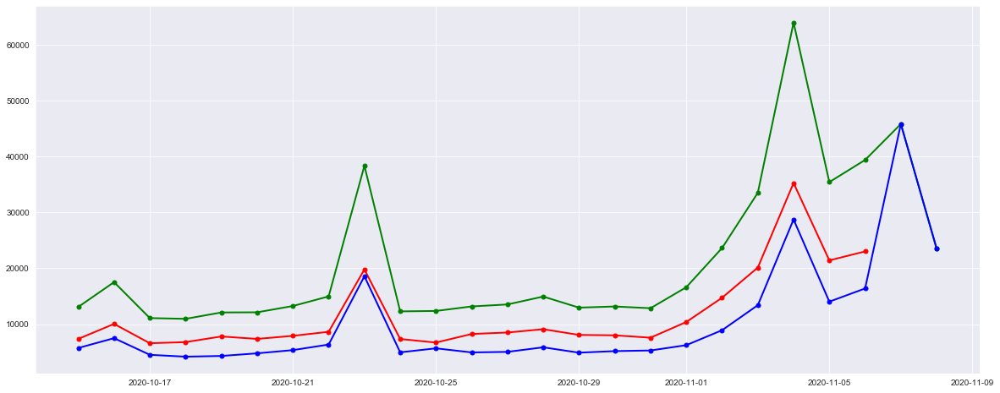

In [127]:
plt.figure(figsize=(20,8))
plt.plot(day_wise_tweets["index"], day_wise_tweets["Total"], 'go-', linewidth=2, markersize=5)
plt.plot(day_wise_tweets["index"], day_wise_tweets["Trump"], 'ro-', linewidth=2, markersize=5)
plt.plot(day_wise_tweets["index"], day_wise_tweets["Biden"], 'bo-', linewidth=2, markersize=5)



## Analysis Inference: Popularity

- There are more tweets related to Trump than Biden.
- The USA has the most amount of interactions(even on a logarithmic scale).
- It seems that on an overall scale, Joe Biden related tweets had more likes and retweets.
- Joe Biden was the most popular in India(barring USA).
- Donald Trump was the most popular in Germany(barring USA).
- It seems that India, the UK, France and Germany are the countries where both candidates' tweets have recieved massive reactions(barring USA).  


Text(0.5, 1.0, 'Number of Tweets per candidate')

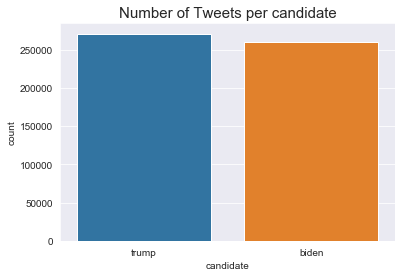

In [34]:
sns.set_style(style="darkgrid")
ax = sns.countplot(x='candidate', data=df)
ax.set_title("Number of Tweets per candidate",fontdict={"size":15})

In [55]:
x = df.groupby(["country", "candidate"]).agg("sum")
likes = x["likes"].unstack()
rts = x["retweet_count"].unstack()

In [56]:
likes.head()

candidate,biden,trump
country,,
Afghanistan,132.0,75.0
Albania,93.0,15.0
Algeria,NaN,1.0
Angola,16.0,68.0
Argentina,4159.0,5183.0


In [57]:
rts.head()

candidate,biden,trump
country,,
Afghanistan,15.0,15.0
Albania,19.0,0.0
Algeria,NaN,0.0
Angola,1.0,1.0
Argentina,1587.0,1581.0


In [61]:
## Lets look at which country are the candidates most popular in...
total_likes = likes.sum()
total_rts = rts.sum()

more_rted_candidate = "Trump" if total_rts["biden"] < total_rts["trump"] else "Biden"
more_liked_candidate = "Trump" if total_likes["biden"] < total_likes["trump"] else "Biden"

print(f"{more_liked_candidate} has more likes overall!")
print(f"{more_rted_candidate} has more Retweetes overall!")


Biden has more likes overall!
Biden has more Retweetes overall!


In [71]:
## Lets see which candidate is more popular per country
trump_top_10 = likes.trump.sort_values(ascending=False)[1:11]
biden_top_10 = likes.biden.sort_values(ascending=False)[1:11]


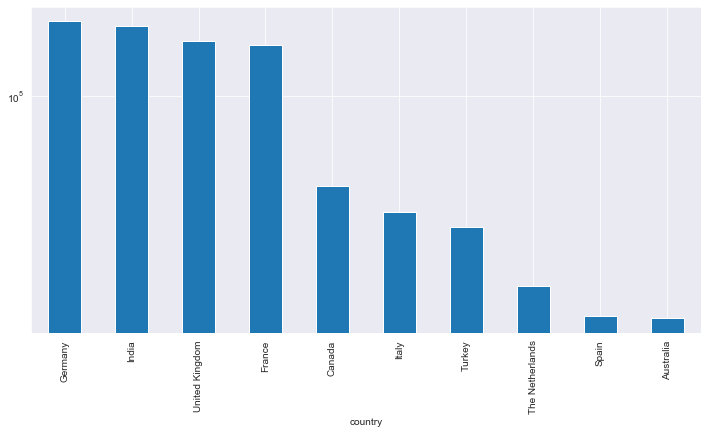

In [72]:
trump_top_10.plot(kind="bar",logy=True,figsize=(12,6))

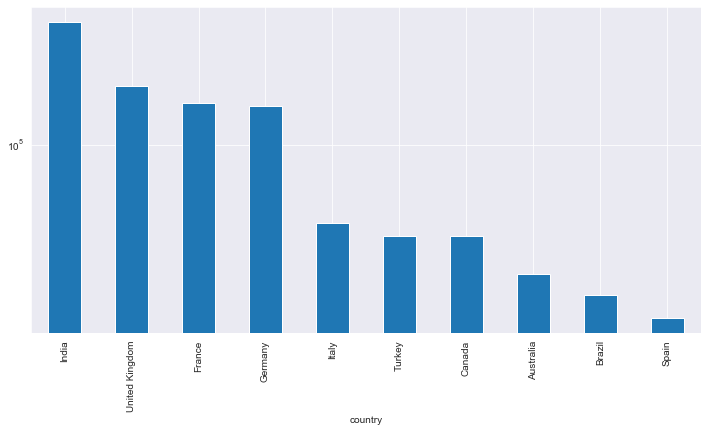

In [73]:
biden_top_10.plot(kind="bar",logy=True,figsize=(12,6))

## Analysis Inference: Tweet Sources

- The USA did significantly higher number of tweets than the other countries.
- As observed in popularity, the countries of UK, India, France and Germany are seen to be tweeting the most.
- Most of the users tweeted from the generic web app or through their phones.
- In phones, iPhone users seem to tweet more compared to android.


Text(0, 0.5, 'TWEETS (LOG SCALE)')

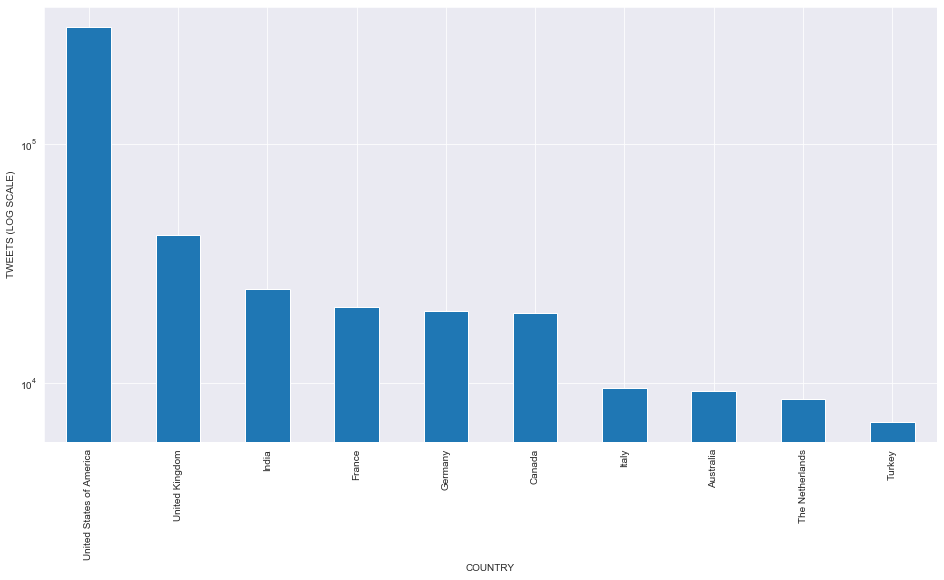

In [74]:
# Top ten countries that tweeted
ax = df.country.value_counts()[:10].plot(kind="bar",figsize=(16,8),logy=True)
ax.set_xlabel("COUNTRY")
ax.set_ylabel("TWEETS (LOG SCALE)")


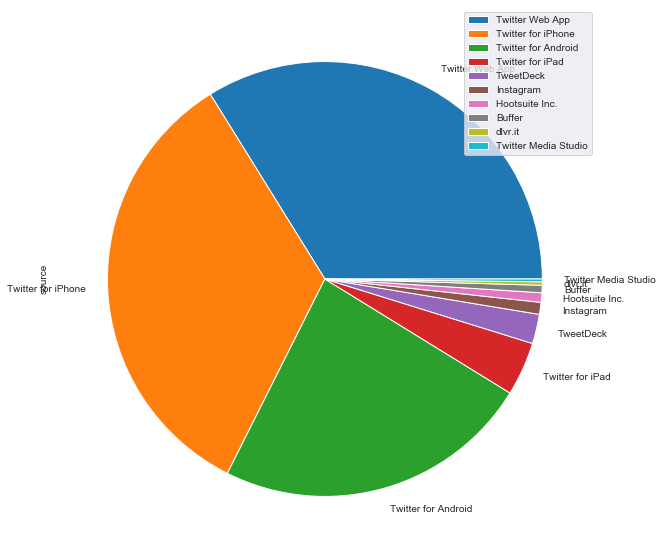

In [75]:
# Top 10 sources of tweets
df.source.value_counts()[:10].plot(kind="pie",figsize=(10, 10),legend=True)

# Visualizing the Geospatial Distribution of Tweets

In this section, we visualize where the tweets come from on an interactive map!

In [28]:
m = folium.Map([37.0902, -95.7129], zoom_start=4)
data = df[['lat', 'long']].to_numpy()[:1500]

popups = df["tweet"].tolist()[:1500]
# plot heatmap
# m.add_children(plugins.HeatMap(data, radius=10,scale_radius=True,blur=10))
plugins.MarkerCluster(data, popups=popups).add_to(m)
m

In [30]:
m = folium.Map([37.0902, -95.7129], zoom_start=4)
data = df[['lat', 'long']].to_numpy()
# plot heatmap
data.shape
m.add_children(plugins.HeatMap(data, radius=10,scale_radius=True,blur=10))
m

In [32]:
#USING FAST MARKER CLUSTER FOR LARGE DATASET
from folium.plugins import FastMarkerCluster

m = folium.Map([37.0902, -95.7129], zoom_start=4)
data = df[['lat', 'long']].to_numpy()[0:30000]

popups = df["tweet"].tolist()[0:30000]
# plot heatmap
# m.add_children(plugins.HeatMap(data, radius=10,scale_radius=True,blur=10))
plugins.FastMarkerCluster(data, popups=popups).add_to(m)
m